In [14]:
import random
import numpy as np
import os.path as path
import os

import tensorflow as tf
import tensorflow.keras as keras
import tensorflow.keras.layers as layers

import imageio
from PIL import Image

from bokeh.plotting import figure
from bokeh.io import show, output_notebook
from bokeh.layouts import grid, row

from image_plotter import show_image, show_images, show_image_probs

In [2]:
output_notebook()

Loading BokehJS ...

# Explore Data

In [3]:
dataroot = "/data/cats_and_dogs_filtered/"

In [4]:
train_dir = path.join(dataroot, "train")
val_dir = path.join(dataroot, "validation")

In [5]:
dogs_train_dir = path.join(train_dir, "dogs")
cats_train_dir = path.join(train_dir, "cats")

dogs_val_dir = path.join(val_dir, "dogs")
cats_val_dir = path.join(val_dir, "cats")

In [6]:
cats = []
for cat in os.listdir(cats_train_dir)[:10]:
    fullpath = path.join(cats_train_dir, cat)
    cats.append(fullpath)
    
dogs = []
for dog in os.listdir(dogs_train_dir)[:10]:
    fullpath = path.join(dogs_train_dir, dog)
    dogs.append(fullpath)

In [7]:
cat_images = []
for cat in cats:
    image = imageio.imread(cat)
    cat_images.append(image)

In [8]:
show_images(cat_images)

In [9]:
dog_images = []
for dog in dogs:
    image = imageio.imread(dog)
    dog_images.append(image)

In [10]:
show_images(dog_images)

In [11]:
dog_images[0].shape

(500, 448, 3)

In [12]:
print(np.min(dog_images[0]), np.max(dog_images[0]))

0 255


At the very least I need to resize the images to a uniform size, and then normalize the pixel values to be between [0, 1].

# Data Pipeline

In [50]:
class DataSet(keras.utils.Sequence):
    def __init__(self, split, batch_size):        
        self._files = []
        self._batch_size = batch_size
        self._cache = None
        
        cat = 0.
        dog = 1.
        dataroot = "/data/cats_and_dogs_filtered/"
        if split == "train":
            dogs_dir = path.join(dataroot, "train", "dogs")
            cats_dir = path.join(dataroot, "train", "cats")
        elif split == "val":
            dogs_dir = path.join(dataroot, "validation", "dogs")
            cats_dir = path.join(dataroot, "validation", "cats")
        for file in os.listdir(dogs_dir):
            file = path.join(dogs_dir, file)
            self._files.append((file, dog))
        for file in os.listdir(cats_dir):
            file = path.join(cats_dir, file)
            self._files.append((file, cat))
        random.shuffle(self._files)
        
    
    def fetchall(self):
        self._cache = []
        for idx in range(len(self)):
            batch = self._load_batch(idx)
            self._cache.append(batch)
    
    def __len__(self):
        return len(self._files) // self._batch_size
    
    def __getitem__(self, idx):
        if self._cache:
            return self._cache[idx]
        else:
            return _load_batch(idx)
    
    def _load_batch(self, idx):
        start_idx = idx * self._batch_size
        end_idx = (idx+1) * self._batch_size
        batch = self._files[start_idx:end_idx]
        images = []
        targets = []
        for file, target in batch:
            img = imageio.imread(file)
            img = Image.fromarray(img)
            img = img.resize((128, 128))
            img = np.array(img, dtype=np.float32)
            img = img / 255.
            images.append(img)
            targets.append(target)
        images = np.array(images)
        targets = np.array(targets)
        return images, targets

In [51]:
trainset = DataSet("train", 32)
trainset.fetchall()
it = iter(trainset)
images, targets = next(it)
print(images.shape, targets.shape)
print(np.min(images), np.max(images))

(32, 128, 128, 3) (32,)
0.0 1.0


In [52]:
ctr = 0
for images, targets in trainset:
    ctr += 1
print(ctr)

62


In [53]:
valset = DataSet("val", 32)
valset.fetchall()
ctr = 0
for images, targets in valset:
    ctr += 1
print(ctr)

31


# Build Model

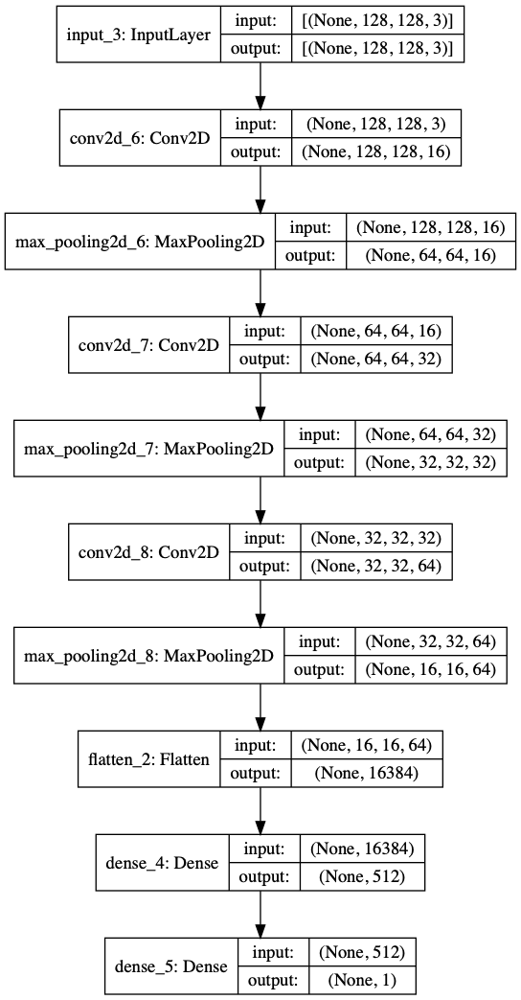

In [41]:
input_ = layers.Input(shape=(128, 128, 3))
x = layers.Conv2D(16, 3, padding="same", activation="relu")(input_)
x = layers.MaxPooling2D()(x)
x = layers.Conv2D(32, 3, padding="same", activation="relu")(x)
x = layers.MaxPooling2D()(x)
x = layers.Conv2D(64, 3, padding="same", activation="relu")(x)
x = layers.MaxPooling2D()(x)
x = layers.Flatten()(x)
x = layers.Dense(512, activation="relu")(x)
output = layers.Dense(1, activation="sigmoid")(x)
model = keras.Model(input_, output)
keras.utils.plot_model(model, show_shapes=True)

In [42]:
it = iter(trainset)
images, targets = next(it)
preds = model(images)
preds.shape

TensorShape([32, 1])

# Train Model

In [44]:
model.compile(
    optimizer="adam",
    loss="binary_crossentropy",
    metrics=["accuracy"]
)

In [54]:
tb = keras.callbacks.TensorBoard(log_dir="./cats-dogs-logs/cats-dogs-3.tb", histogram_freq=1, update_freq="epoch")
model.fit(
    trainset,
    validation_data=valset,
    shuffle=True,
    epochs=15,
    callbacks=[tb]
)

Epoch 1/15
62/62 [==============================] - 14s 232ms/step - loss: 0.0645 - accuracy: 0.9798 - val_loss: 1.1452 - val_accuracy: 0.7268
Epoch 2/15
62/62 [==============================] - 14s 230ms/step - loss: 0.0395 - accuracy: 0.9894 - val_loss: 1.2997 - val_accuracy: 0.7228
Epoch 3/15
62/62 [==============================] - 15s 235ms/step - loss: 0.0406 - accuracy: 0.9874 - val_loss: 1.3402 - val_accuracy: 0.7067
Epoch 4/15
62/62 [==============================] - 14s 232ms/step - loss: 0.0229 - accuracy: 0.9960 - val_loss: 1.4798 - val_accuracy: 0.7107
Epoch 5/15
62/62 [==============================] - 14s 232ms/step - loss: 0.0069 - accuracy: 0.9990 - val_loss: 1.5450 - val_accuracy: 0.7228
Epoch 6/15
62/62 [==============================] - 15s 236ms/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 1.5948 - val_accuracy: 0.7177
Epoch 7/15
62/62 [==============================] - 14s 234ms/step - loss: 6.8174e-04 - accuracy: 1.0000 - val_loss: 1.6369 - val_accuracy: 0.

Looks like the model is overfitting pretty hard. The simplest thing to try is L2 regularization on all the weights. I'll need to rebuild the model for this.

In [60]:
l2_reg = keras.regularizers.l2(0.01)

input_ = layers.Input(shape=(128, 128, 3))
x = layers.Conv2D(16, 3, padding="same", activation="relu", kernel_regularizer=l2_reg)(input_)
x = layers.MaxPooling2D()(x)
x = layers.Conv2D(32, 3, padding="same", activation="relu", kernel_regularizer=l2_reg)(x)
x = layers.MaxPooling2D()(x)
x = layers.Conv2D(64, 3, padding="same", activation="relu", kernel_regularizer=l2_reg)(x)
x = layers.MaxPooling2D()(x)
x = layers.Flatten()(x)
x = layers.Dense(512, activation="relu", kernel_regularizer=l2_reg)(x)
output = layers.Dense(1, activation="sigmoid", kernel_regularizer=l2_reg)(x)
model = keras.Model(input_, output)

In [61]:
model.compile(
    optimizer="adam",
    loss="binary_crossentropy",
    metrics=["accuracy"]
)

In [62]:
tb = keras.callbacks.TensorBoard(log_dir="./cats-dogs-logs/cats-dogs-4.tb", histogram_freq=1, update_freq="epoch")
model.fit(
    trainset,
    validation_data=valset,
    shuffle=True,
    epochs=15,
    callbacks=[tb]
)

Epoch 1/15
62/62 [==============================] - 17s 281ms/step - loss: 2.3258 - accuracy: 0.5262 - val_loss: 0.9134 - val_accuracy: 0.5000
Epoch 2/15
62/62 [==============================] - 16s 259ms/step - loss: 0.8335 - accuracy: 0.5302 - val_loss: 0.7863 - val_accuracy: 0.5020
Epoch 3/15
62/62 [==============================] - 15s 246ms/step - loss: 0.7686 - accuracy: 0.5358 - val_loss: 0.7515 - val_accuracy: 0.5655
Epoch 4/15
62/62 [==============================] - 15s 248ms/step - loss: 0.7424 - accuracy: 0.5101 - val_loss: 0.7324 - val_accuracy: 0.5020
Epoch 5/15
62/62 [==============================] - 16s 253ms/step - loss: 0.7269 - accuracy: 0.5353 - val_loss: 0.7204 - val_accuracy: 0.5645
Epoch 6/15
62/62 [==============================] - 15s 241ms/step - loss: 0.7169 - accuracy: 0.5227 - val_loss: 0.7134 - val_accuracy: 0.5151
Epoch 7/15
62/62 [==============================] - 15s 244ms/step - loss: 0.7109 - accuracy: 0.5403 - val_loss: 0.7080 - val_accuracy: 0.5282

That helped but not a whole lot. Lets try other regularizers starting with data augmentation.

# Data Augmentation
The idea behind data augmentation is that my dataset size remains the same, i.e., I'll still learn from 2000 images per epoch. But the idea is that every epoch will be different. If applied a random crop to image_0 in epoch n, I might end up applying random zoom to image_0 when it is served up in epoch n+1.

So my Sequencer logic will be something like -
  * choose the batch of files that will be served for this epoch/batch.
  * for each image in this batch, don't serve it as-is, randomly choose a distortion and apply it.

In [75]:
file0, _ = trainset._files[0]
file1, _ = trainset._files[1]

In [84]:
data0 = imageio.imread(file0)
data1 = imageio.imread(file1)

In [78]:
show_images([img0, img1])

Lets try horizontal flip first.

In [85]:
img0 = Image.fromarray(data0)
mir_img0 = img0.transpose(method=Image.FLIP_LEFT_RIGHT)

img1 = Image.fromarray(data1)
mir_img1 = img1.transpose(method=Image.FLIP_LEFT_RIGHT)

In [86]:
show_images([img0, mir_img0, img1, mir_img1])

Now rotate the image by 45 deg.

In [87]:
rot_img0 = img0.rotate(45)
rot_img1 = img1.rotate(45)
show_images([img0, rot_img0, img1, rot_img1])

To randomly zoom, randomly crop the image, and then resize it.

In [104]:
w, h = img0.size
print(w, h)

499 378


In [103]:
new_width = np.random.randint(w//2, w)
new_height = np.random.randint(h//2, h)
print(new_width, new_height)

450 205


In [105]:
top_left = np.random.randint(w-new_width), np.random.randint(h-new_height)
top_left

(11, 42)

In [108]:
bottom_right = top_left[0]+new_width, top_left[1]+new_height

In [109]:
crop_img0 = img0.crop((top_left[0], top_left[1], bottom_right[0], bottom_right[1]))
zoom_img0 = crop_img0.resize((128, 128))

In [110]:
show_image(zoom_img0)

In [120]:
def zoom(orig):
    img = orig.resize((128, 128))
    new_len = np.random.randint(64, 128)
    top_left_x = np.random.randint(128 - new_len)
    top_left_y = np.random.randint(128 - new_len)
    bottom_right_x = top_left_x + new_len
    bottom_right_y = top_left_y + new_len
    crop_img = img.crop((top_left_x, top_left_y, bottom_right_x, bottom_right_y))
    zoom_img = crop_img.resize((128, 128))
    return zoom_img

In [121]:
zoom_img1 = zoom(img1)
show_image(zoom_img1)

In [115]:
np.random.randint(64, 128, (2,))

array([ 87, 127])

# Create new pipeline

In [123]:
def resize(img):
    return img.resize((128, 128))


def mirror(img):
    return img.transpose(method=Image.FLIP_LEFT_RIGHT)


def rotate(img):
    return img.rotate(45)


def zoom(img):
    new_len = np.random.randint(64, 128)
    top_left_x = np.random.randint(128 - new_len)
    top_left_y = np.random.randint(128 - new_len)
    bottom_right_x = top_left_x + new_len
    bottom_right_y = top_left_y + new_len
    crop_img = img.crop((top_left_x, top_left_y, bottom_right_x, bottom_right_y))
    zoom_img = crop_img.resize((128, 128))
    return zoom_img

In [152]:
class DataSet(keras.utils.Sequence):
    def __init__(self, split, batch_size):
        self._split = split
        self._batch_size = batch_size
        self._files = []
        self._funcs = [mirror, rotate, zoom]
        
        cat = 0.
        dog = 1.
        dataroot = "/data/cats_and_dogs_filtered/"
        dogs_dir = path.join(dataroot, split, "dogs")
        cats_dir = path.join(dataroot, split, "cats")
        for file in os.listdir(dogs_dir):
            file = path.join(dogs_dir, file)
            self._files.append((file, dog))
        for file in os.listdir(cats_dir):
            file = path.join(cats_dir, file)
            self._files.append((file, cat))
        random.shuffle(self._files)
        
        self._cache = []
        for file, target in self._files:
            img = imageio.imread(file)
            img = Image.fromarray(img)
            img = img.resize((128, 128))
            self._cache.append((img, target))

    def __len__(self):
        return len(self._files) // self._batch_size
    
    def __getitem__(self, idx):
        start_idx = idx * self._batch_size
        end_idx = (idx+1) * self._batch_size
        batch = self._cache[start_idx:end_idx]
        images = []
        targets = []
        for image, target in batch:
            if self._split == "train":
                func = random.choice(self._funcs)
                image = func(image)
            image = np.array(image)
            image = image / 255.
            images.append(image)
            targets.append(target)
        images = np.array(images)
        targets = np.array(targets)
        return images, targets

In [153]:
trainset = DataSet("train", 32)
valset = DataSet("validation", 32)

In [154]:
images, targets = trainset[42]
print(images.shape, targets.shape)

(32, 128, 128, 3) (32,)


In [161]:
l2_reg = keras.regularizers.l2(0.01)

input_ = layers.Input(shape=(128, 128, 3))
x = layers.Conv2D(16, 3, padding="same", activation="relu", kernel_regularizer=l2_reg)(input_)
x = layers.MaxPooling2D()(x)
x = layers.Conv2D(32, 3, padding="same", activation="relu", kernel_regularizer=l2_reg)(x)
x = layers.MaxPooling2D()(x)
x = layers.Conv2D(64, 3, padding="same", activation="relu", kernel_regularizer=l2_reg)(x)
x = layers.MaxPooling2D()(x)
x = layers.Flatten()(x)
x = layers.Dense(512, activation="relu", kernel_regularizer=l2_reg)(x)
output = layers.Dense(1, activation="sigmoid", kernel_regularizer=l2_reg)(x)
model = keras.Model(input_, output)

model.compile(
    optimizer="adam",
    loss="binary_crossentropy",
    metrics=["accuracy"]
)

tb = keras.callbacks.TensorBoard(log_dir="./cats-dogs-logs/cats-dogs-6.tb", histogram_freq=1, update_freq="epoch")

history = model.fit(
    trainset,
    validation_data=valset,
    shuffle=True,
    epochs=5,
    callbacks=[tb],
    verbose=2
)

Epoch 1/5
62/62 - 15s - loss: 2.6536 - accuracy: 0.4924 - val_loss: 1.0406 - val_accuracy: 0.4950
Epoch 2/5
62/62 - 14s - loss: 0.9175 - accuracy: 0.4995 - val_loss: 0.8495 - val_accuracy: 0.5403
Epoch 3/5
62/62 - 15s - loss: 0.8220 - accuracy: 0.5086 - val_loss: 0.7987 - val_accuracy: 0.5010
Epoch 4/5
62/62 - 15s - loss: 0.7838 - accuracy: 0.4899 - val_loss: 0.7705 - val_accuracy: 0.5474
Epoch 5/5
62/62 - 15s - loss: 0.7610 - accuracy: 0.5005 - val_loss: 0.7520 - val_accuracy: 0.5020


Model does not seem to have learnt anything. Maybe get rid of the regularizers might help.

In [163]:
input_ = layers.Input(shape=(128, 128, 3))
x = layers.Conv2D(16, 3, padding="same", activation="relu")(input_)
x = layers.MaxPooling2D()(x)
x = layers.Conv2D(32, 3, padding="same", activation="relu")(x)
x = layers.MaxPooling2D()(x)
x = layers.Conv2D(64, 3, padding="same", activation="relu")(x)
x = layers.MaxPooling2D()(x)
x = layers.Flatten()(x)
x = layers.Dense(512, activation="relu")(x)
output = layers.Dense(1, activation="sigmoid")(x)
model = keras.Model(input_, output)

In [164]:
model.compile(
    optimizer="adam",
    loss="binary_crossentropy",
    metrics=["accuracy"]
)

In [160]:
tb = keras.callbacks.TensorBoard(log_dir="./cats-dogs-logs/cats-dogs-7.tb", histogram_freq=1, update_freq="epoch")
history = model.fit(
    trainset,
    validation_data=valset,
    shuffle=True,
    epochs=5,
    callbacks=[tb],
    verbose=2
)

Epoch 1/5
62/62 - 15s - loss: 0.7435 - accuracy: 0.5050 - val_loss: 0.6897 - val_accuracy: 0.5040
Epoch 2/5
62/62 - 15s - loss: 0.6902 - accuracy: 0.5262 - val_loss: 0.6813 - val_accuracy: 0.5958
Epoch 3/5
62/62 - 15s - loss: 0.6712 - accuracy: 0.6074 - val_loss: 0.6590 - val_accuracy: 0.6169
Epoch 4/5
62/62 - 14s - loss: 0.6302 - accuracy: 0.6502 - val_loss: 0.6312 - val_accuracy: 0.6431
Epoch 5/5
62/62 - 14s - loss: 0.6022 - accuracy: 0.6709 - val_loss: 0.5833 - val_accuracy: 0.6915


This is better than before. Getting rid of L2 regularizer helped. Let me run the full 15 epochs and see what the final validation score comes out.

In [165]:
tb = keras.callbacks.TensorBoard(log_dir="./cats-dogs-logs/cats-dogs-8.tb", histogram_freq=1, update_freq="epoch")
model.reset_states()
model.reset_metrics()
history = model.fit(
    trainset,
    validation_data=valset,
    shuffle=True,
    epochs=15,
    callbacks=[tb],
    verbose=2
)

Epoch 1/15
62/62 - 15s - loss: 0.6868 - accuracy: 0.5302 - val_loss: 0.6463 - val_accuracy: 0.6381
Epoch 2/15
62/62 - 14s - loss: 0.6324 - accuracy: 0.6416 - val_loss: 0.6070 - val_accuracy: 0.6875
Epoch 3/15
62/62 - 14s - loss: 0.6096 - accuracy: 0.6633 - val_loss: 0.5836 - val_accuracy: 0.6714
Epoch 4/15
62/62 - 14s - loss: 0.5850 - accuracy: 0.6830 - val_loss: 0.5824 - val_accuracy: 0.6986
Epoch 5/15
62/62 - 14s - loss: 0.5762 - accuracy: 0.6915 - val_loss: 0.5727 - val_accuracy: 0.7056
Epoch 6/15
62/62 - 14s - loss: 0.5727 - accuracy: 0.6981 - val_loss: 0.5552 - val_accuracy: 0.7087
Epoch 7/15
62/62 - 14s - loss: 0.5552 - accuracy: 0.7203 - val_loss: 0.5356 - val_accuracy: 0.7329
Epoch 8/15
62/62 - 14s - loss: 0.5298 - accuracy: 0.7359 - val_loss: 0.5271 - val_accuracy: 0.7440
Epoch 9/15
62/62 - 14s - loss: 0.5152 - accuracy: 0.7389 - val_loss: 0.5290 - val_accuracy: 0.7369
Epoch 10/15
62/62 - 14s - loss: 0.5016 - accuracy: 0.7379 - val_loss: 0.6031 - val_accuracy: 0.6643
Epoch 11/